# Датасет

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
JsonPath = '/content/drive/MyDrive/train.json'
ForHashPath = '/content/drive/MyDrive/TestHash.txt'

In [ ]:
import json

with open(JsonPath) as f:
  data = json.load(f)

In [ ]:
""" 
datapiece example:
{'dialog': [[style, utterance], ...], 'image_hash': hash}
"""
data[0]

{'dialog': [['Appreciative (Grateful)', 'home sweet home'],
  ['Glamorous', 'in my big house'],
  ['Appreciative (Grateful)', 'Its a house, so like it']],
 'image_hash': '5eaa7034d31688ef1f9bed67f1f04f49'}

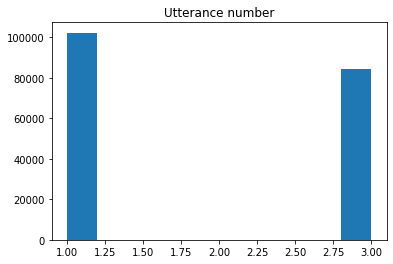

In [ ]:
import matplotlib.pyplot as plt

sent_lenghts = list(map(lambda x: len(x['dialog']), data))
plt.hist(sent_lenghts)
plt.title('Utterance number')
plt.show()

In [ ]:
styles_set = set()

for elem in data:
  dialog = elem['dialog']
  styles_set.add(dialog[0][0])
  if len(dialog) > 1:
    styles_set.add(dialog[1][0])

In [ ]:
styles_count = {style: 0 for style in styles_set}

In [ ]:
for elem in data:
  dialog = elem['dialog']
  styles_count[dialog[0][0]] += 1
  if len(dialog) > 1:
    styles_count[dialog[1][0]] += 1

In [ ]:
# стили и количества
# Earnest, Crude - выбросы слишком мало
sorted(styles_count.items(), key=lambda x: x[1])

[('Earnest', 1),
 ('Crude', 4),
 ('Cold', 1223),
 ('Earnest (Enthusiastic)', 1232),
 ('Hateful', 1235),
 ('Kind', 1235),
 ('Mystical', 1240),
 ('Intense', 1241),
 ('Extravagant', 1241),
 ('Practical', 1242),
 ('Logical', 1245),
 ('Scholarly', 1245),
 ('Wise', 1246),
 ('Scornful', 1246),
 ('Vacuous (Empty, Unintelligent)', 1246),
 ('Coarse (Not Fine, Crass)', 1246),
 ('Peaceful', 1246),
 ('Dry', 1246),
 ('Outrageous', 1247),
 ('Considerate', 1247),
 ('Rational', 1247),
 ('Odd', 1247),
 ('Morbid', 1248),
 ('Cowardly', 1248),
 ('Deep', 1248),
 ('Barbaric', 1248),
 ('Glamorous', 1249),
 ('Patriotic', 1249),
 ('Cultured (Refined, Educated)', 1249),
 ('Compassionate (Sympathetic, Warm)', 1251),
 ('Neutral', 1251),
 ('Maternal (Mother-like)', 1252),
 ('Gentle', 1252),
 ('Haughty (Arrogant, Snobbish)', 1252),
 ('Captivating', 1253),
 ('Imaginative', 1253),
 ('Contemplative (Reflective, Thoughtful)', 1254),
 ('Crazy', 1254),
 ('Youthful', 1254),
 ('Blunt', 1254),
 ('Stylish', 1254),
 ('Exciting

In [ ]:
# все предложения из выборки

sentences_full = np.array([sent[1] for elem in data for sent in elem['dialog']])
styles_full = np.array([sent[0] for elem in data for sent in elem['dialog']])

In [ ]:
# словарь (стиль: список предложений)

styles_to_sentences = {style: [] for style in styles_set}
for elem in data:
  for sent in elem['dialog']:
    styles_to_sentences[sent[0]].append(sent[1])

## Анализ датасета: тематическое моделирование

Идея: кластеризовать исходные предложения, посмотреть, какие темы задают кластеры, попробовать выделить похожие предложения.

Подход: применить TfIdfVectorizer/CountVectorizer к исходным предложениям, ппостроить над векторизованными предложениями kMeans/LDA, попробовать выделить темы. 

In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from wordcloud import WordCloud

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

sents_preproc_full = list(map(lambda sent: preprocess(sent), sentences_full))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

Облако тегов для всего корпуса: не информативно, в нем отображаются какие-то общие слова.

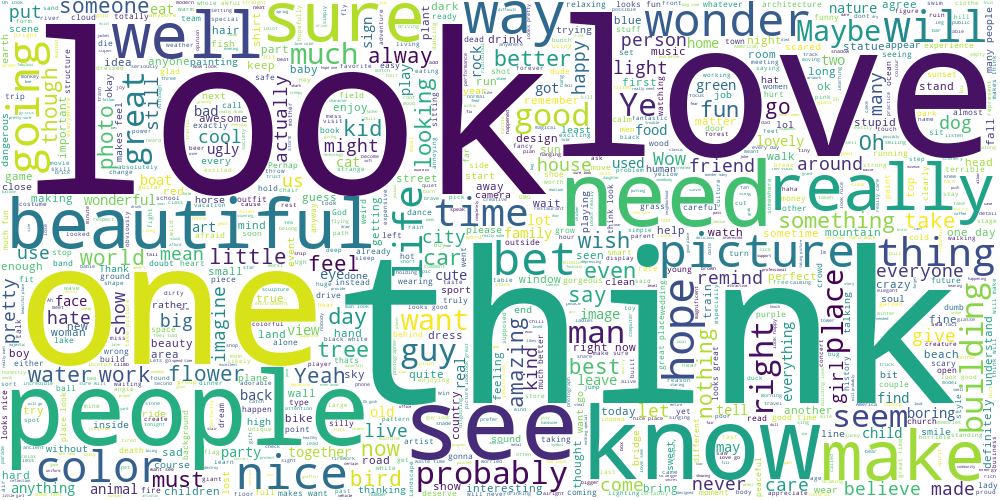

In [ ]:
draw_wordcloud(sentences_full)

In [ ]:
import re
import numpy as np
import pandas as pd
from pprint import pprint
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
import spacy
import matplotlib.pyplot as plt
%matplotlib inline
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)
import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

def remove_stopwords(texts):
    return [[word for word in gensim.utils.simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))

data=sentences_full
data_words = list(sent_to_words(data))
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100)
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)
data_words_nostops = remove_stopwords(data_words)
data_words_bigrams = make_bigrams(data_words_nostops)
nlp = spacy.load('en', disable=['parser', 'ner'])
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])
id2word = corpora.Dictionary(data_lemmatized)
texts = data_lemmatized
corpus = [id2word.doc2bow(text) for text in texts]

In [ ]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=num_topics, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
    return model_list, coherence_values

model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=data_lemmatized, start=2, limit=40, step=6)

In [ ]:
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import gensim

def build_clusters(sentences, num_clusters=5, vec_type='tf_idf'):
  if vec_type == 'tf_idf':
    vec = TfidfVectorizer(min_df=0.05, max_df=0.95) 
  else:
    vec = CountVectorizer()
  
  transformed = vec.fit_transform(sentences)
  kmeans = KMeans(num_clusters)
  labels = kmeans.fit_predict(transformed)

  return labels

In [ ]:
def display_clusters(sentences, labels):
  clusters_num = len(np.unique(labels))
  for label in range(clusters_num):
    print(f"\n*********************************\nlabel {label}\n*********************************\n")
    display(draw_wordcloud(np.array(sentences)[np.arange(len(sentences))[labels == label]]))

def print_cluster_samples(sentences, labels, num_samples=20):
  clusters_num = len(np.unique(labels))
  for label in range(clusters_num):
    print(f"\n*********************************\nlabel {label}\n*********************************\n")
    idxs = np.arange(len(labels))[labels == label]
    for i in np.random.randint(0, np.sum(labels == label), size=num_samples):
      print(sentences[idxs[i]])

def print_cluster_stats(sentences, labels, num_samples=20):
  clusters_num = len(np.unique(labels))
  for label in range(clusters_num):
    print(f"\n*********************************\nlabel {label}\n*********************************\n")
    idxs = np.arange(len(labels))[labels == label]
    sentences_of_label = sentences[idxs]
    styles = np.unique(styles_full[idxs])
    print(f"Different styles: {len(styles)}")
    print(f"Mean sentence length: {np.mean(list(map(len, sentences_of_label)))}")

In [ ]:
labels_full = build_clusters(sents_preproc_full, 30, 'count')

Подход с kMeans: для каждой темы выделилось в основном одно общее слово. Количество кластеров не оптимально, но по облакам тегов можно составить некоторое представление о структуре предложений.

В основном в датасете речь идет об общих впечатлениях (что-то выглядит <прилагательное>/предложение куда-то отправиться/пожелание/совет/фраза о том, что что-то нравится или нет/отношение к времяпровождению и т.д.)


*********************************
label 0
*********************************



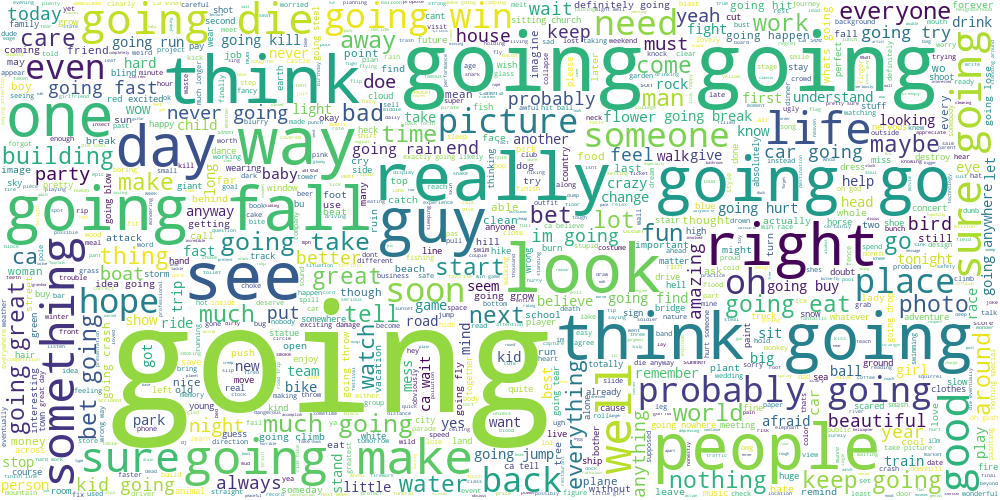


*********************************
label 1
*********************************



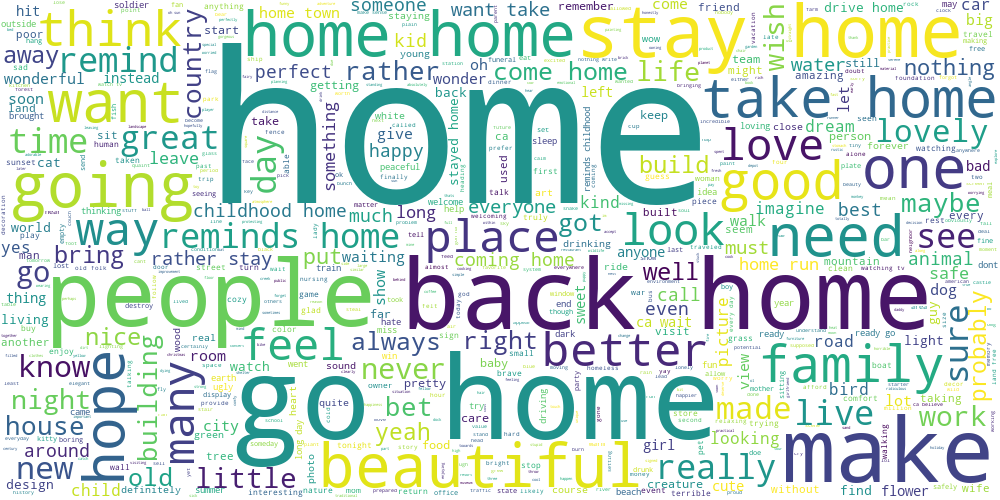


*********************************
label 2
*********************************



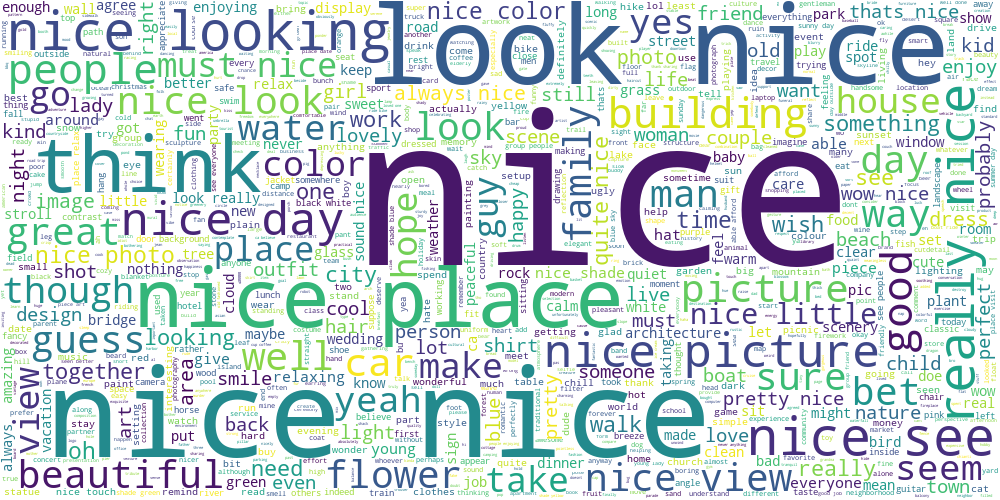


*********************************
label 3
*********************************



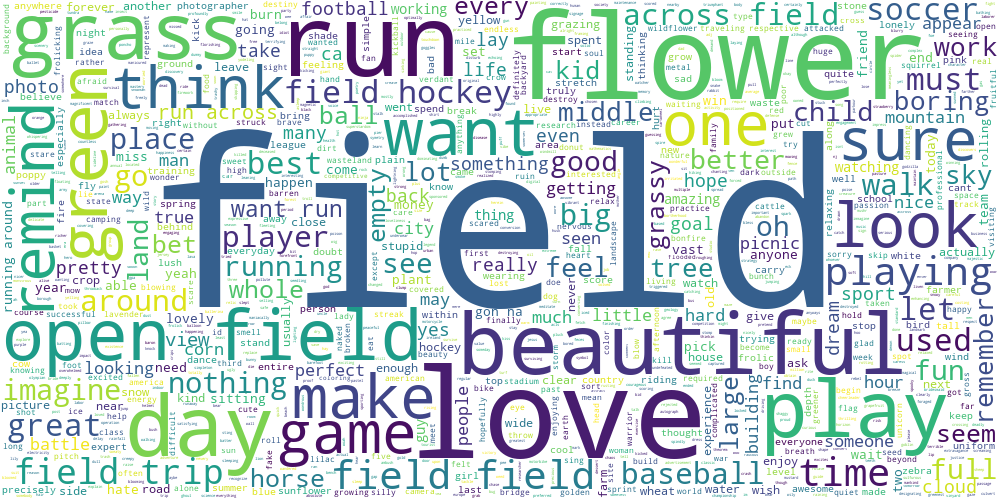


*********************************
label 4
*********************************



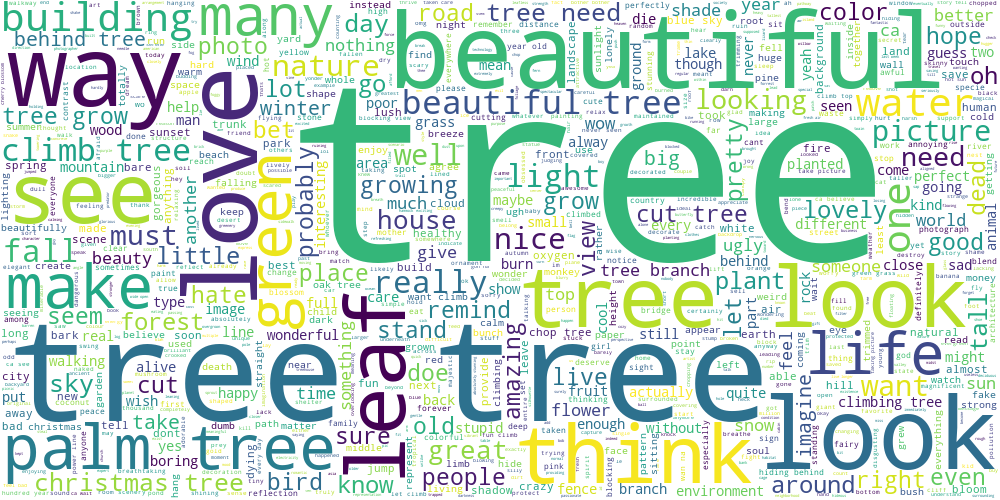


*********************************
label 5
*********************************



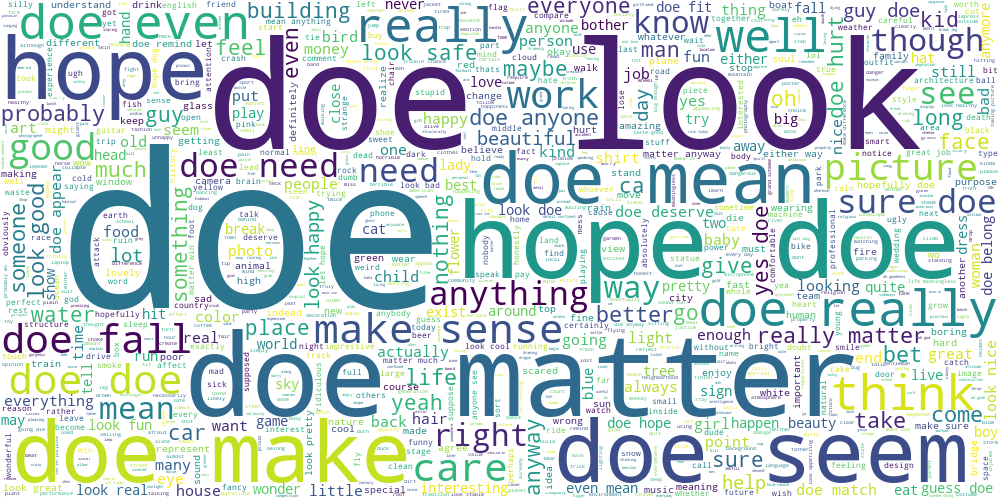


*********************************
label 6
*********************************



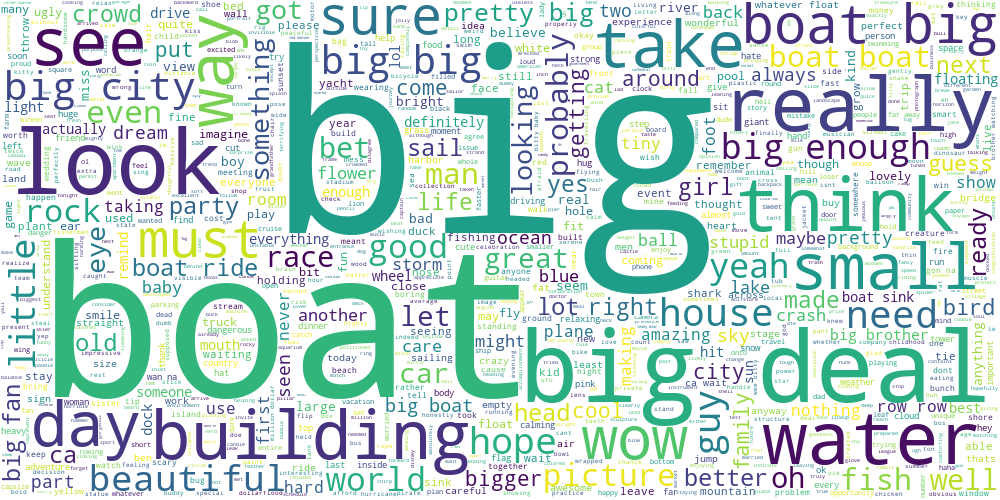


*********************************
label 7
*********************************



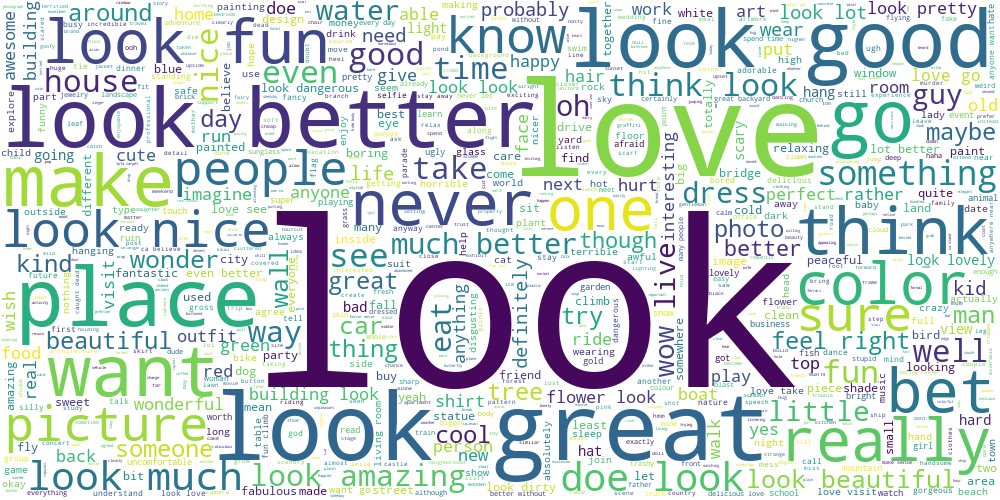


*********************************
label 8
*********************************



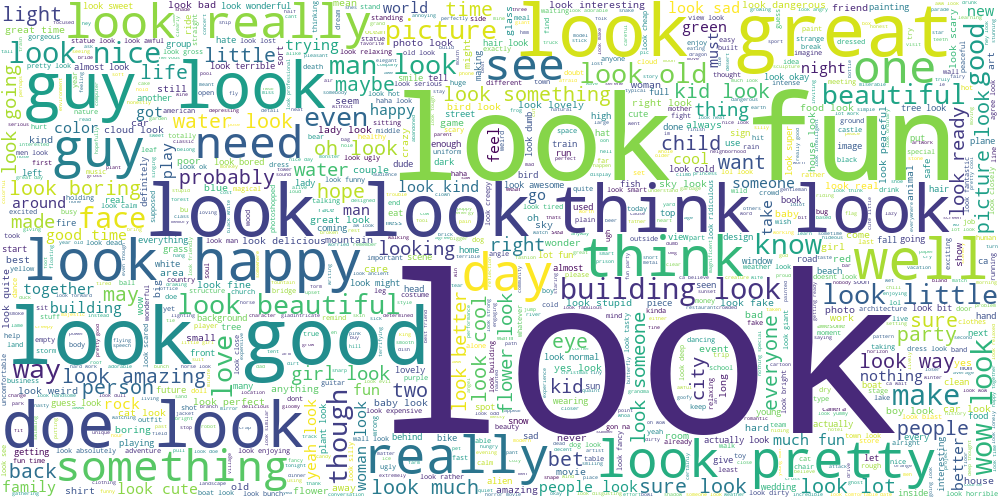


*********************************
label 9
*********************************



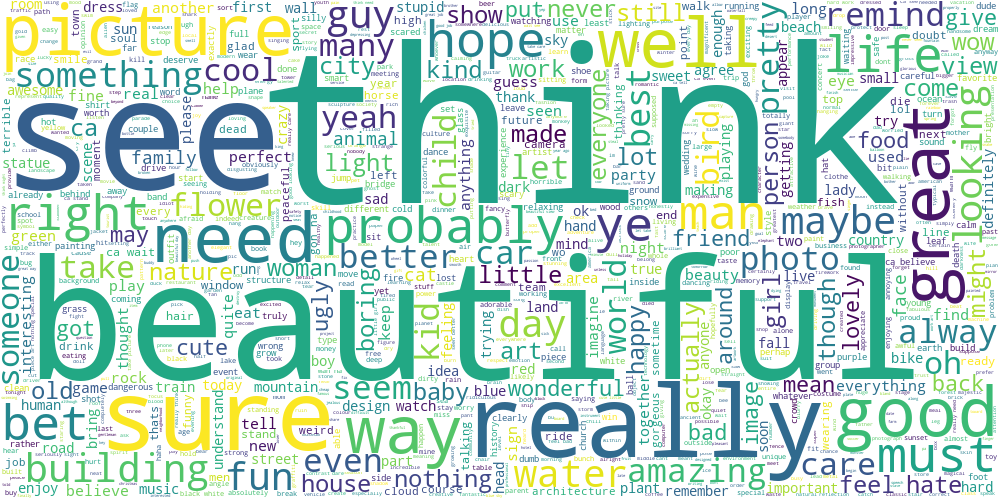


*********************************
label 10
*********************************



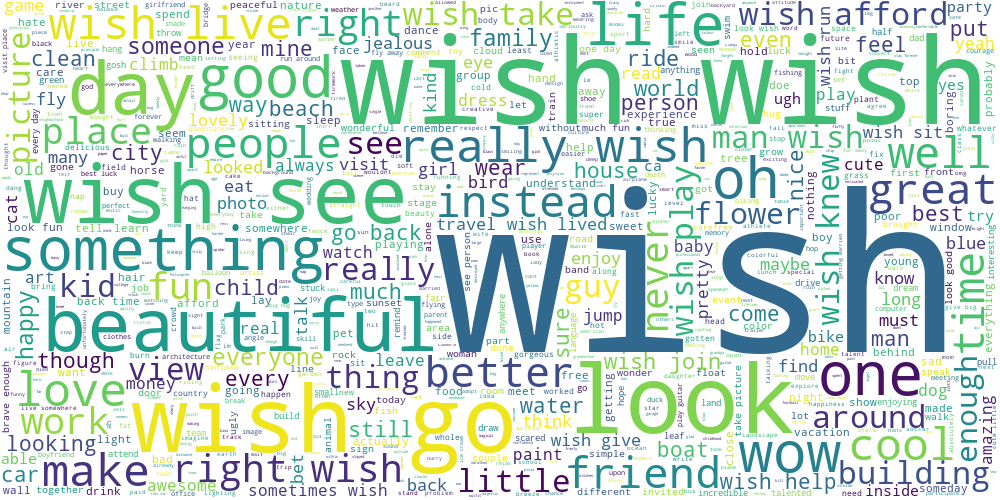


*********************************
label 11
*********************************



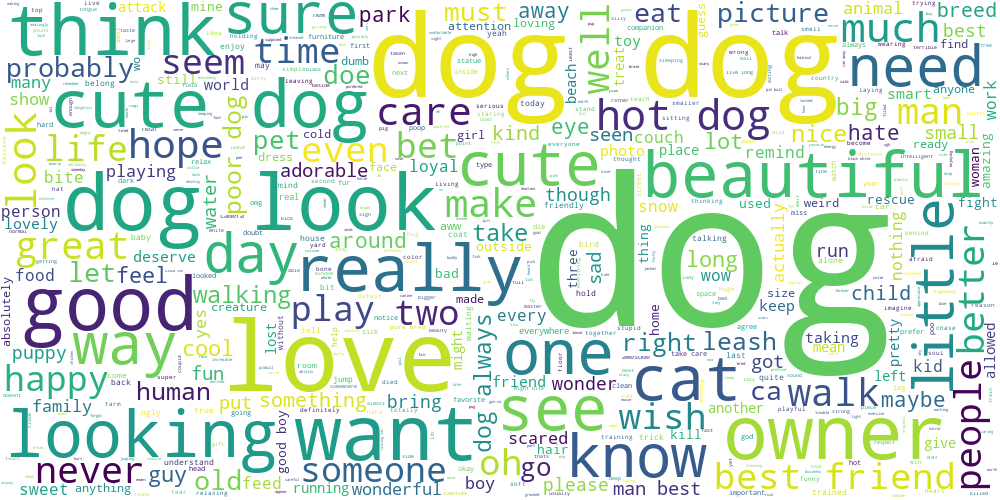


*********************************
label 12
*********************************



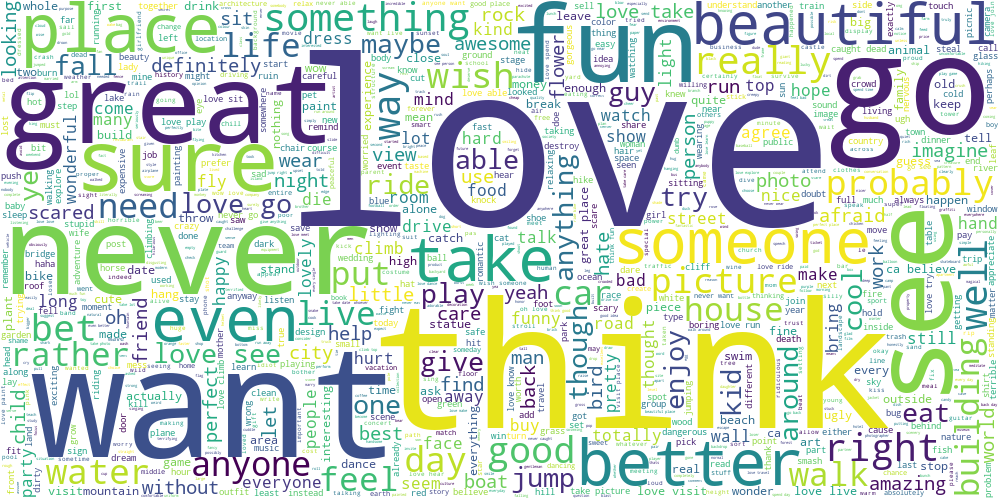


*********************************
label 13
*********************************



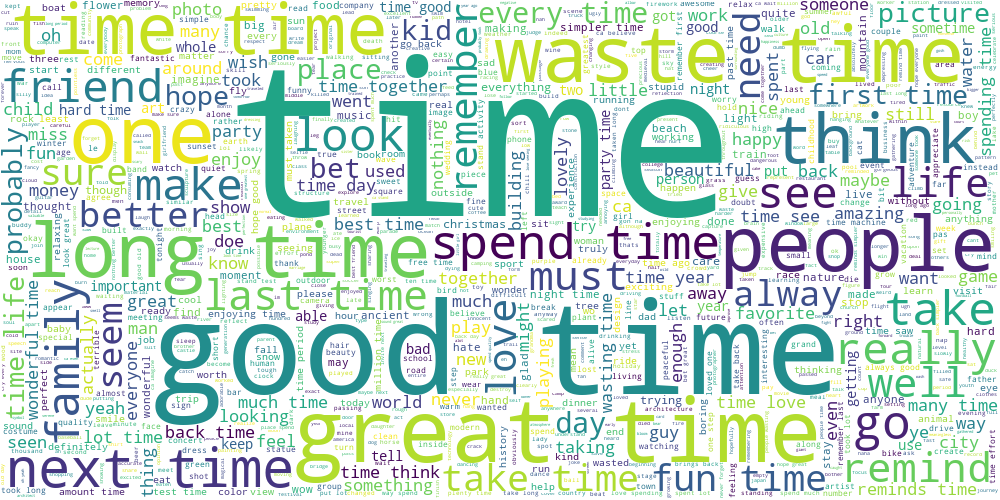


*********************************
label 14
*********************************



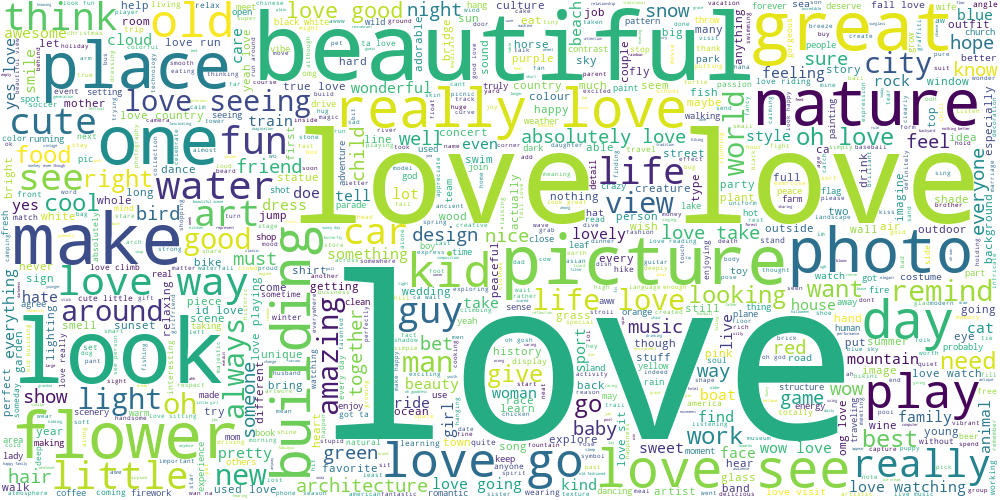


*********************************
label 15
*********************************



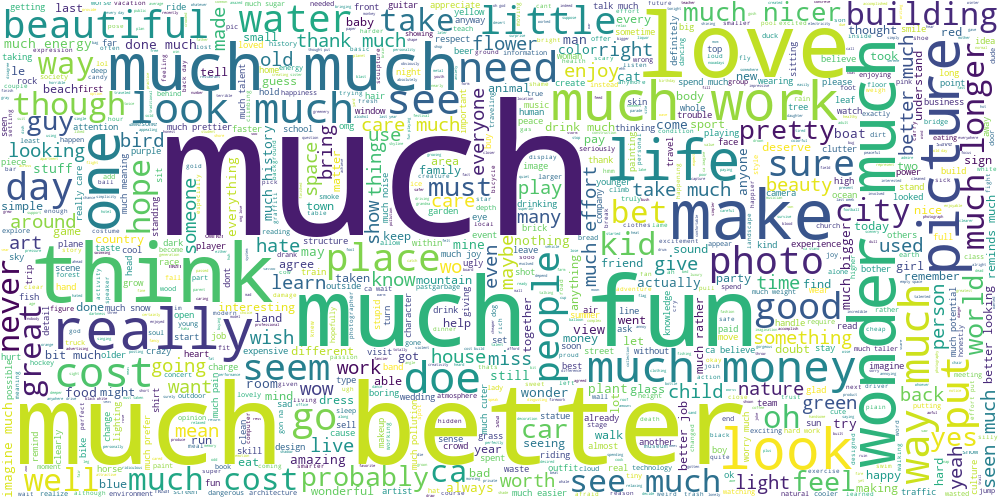


*********************************
label 16
*********************************



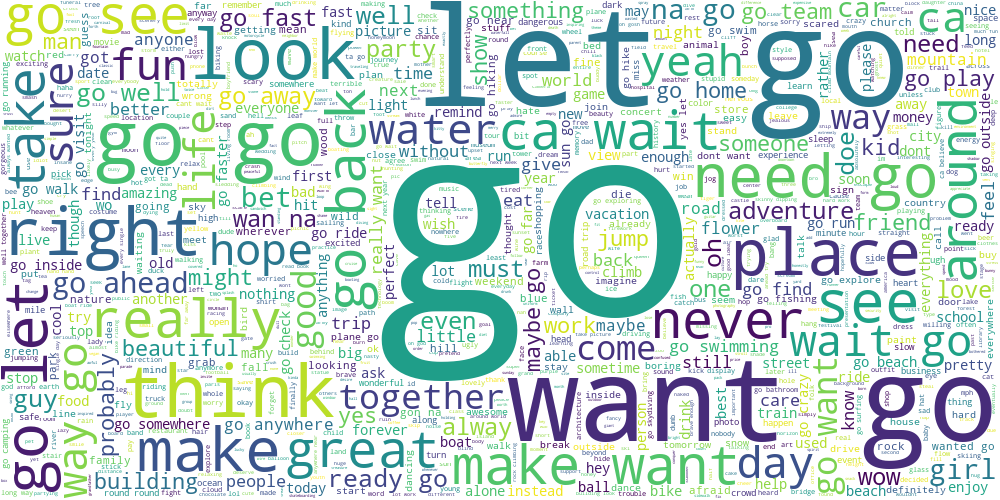


*********************************
label 17
*********************************



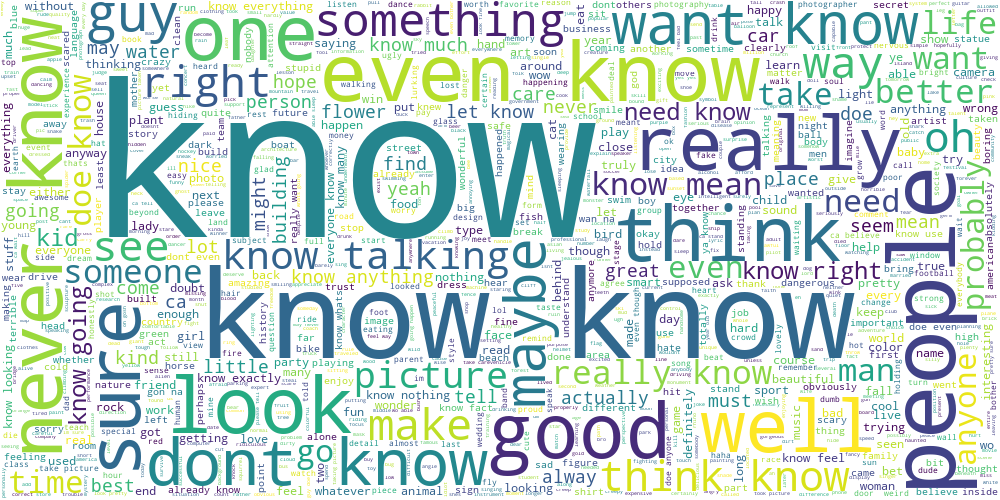


*********************************
label 18
*********************************



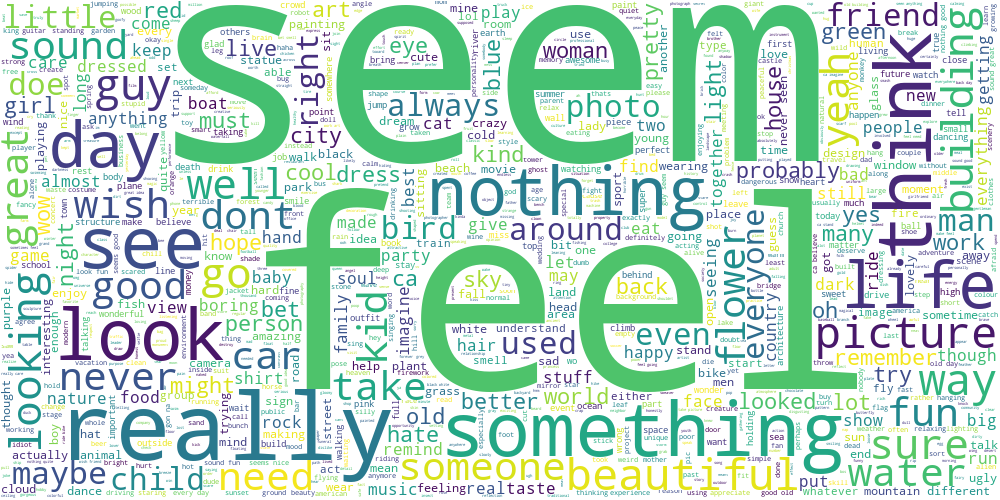


*********************************
label 19
*********************************



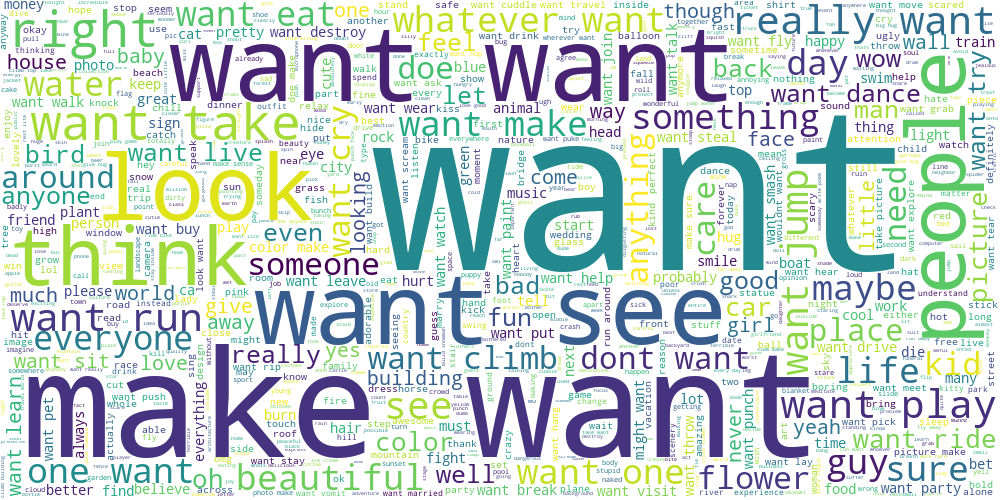


*********************************
label 20
*********************************



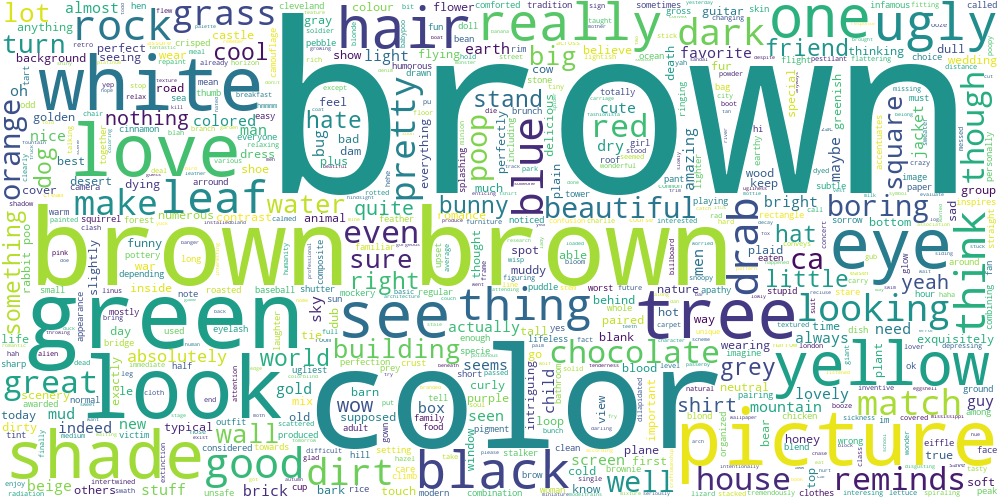


*********************************
label 21
*********************************



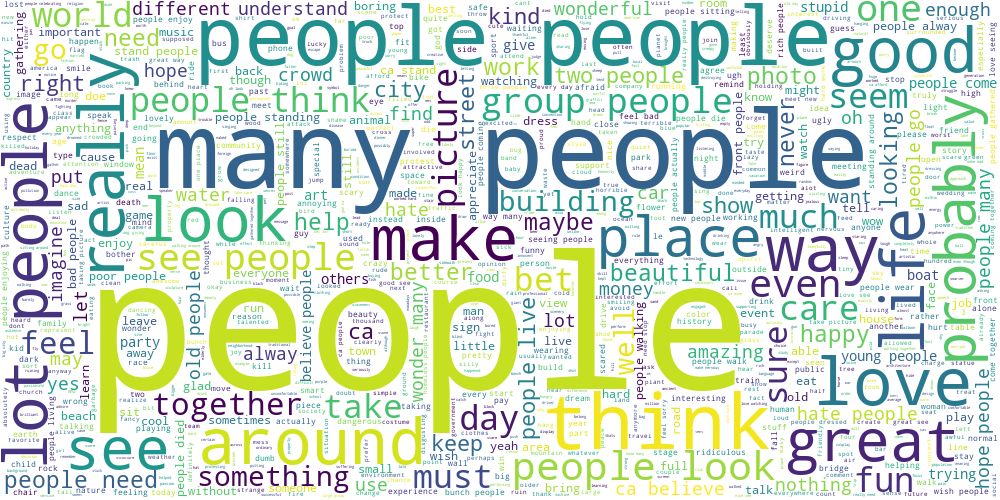


*********************************
label 22
*********************************



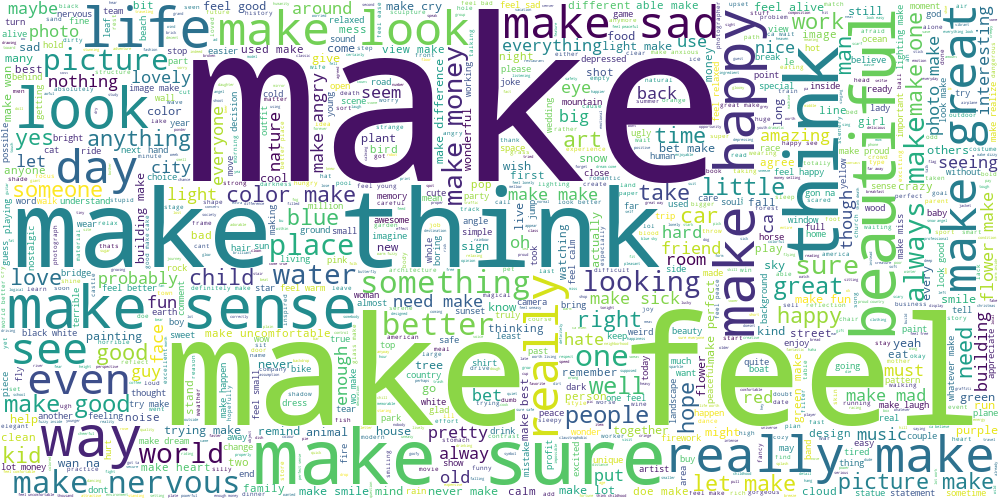


*********************************
label 23
*********************************



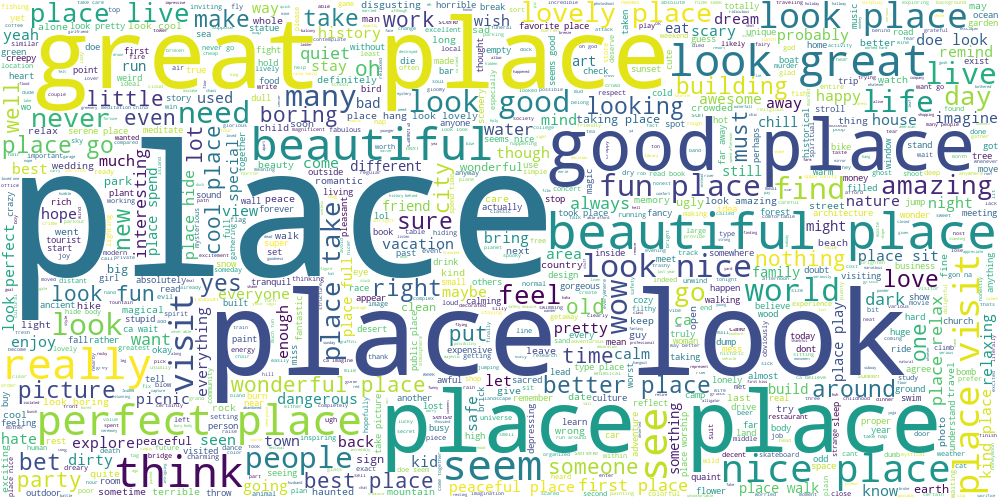


*********************************
label 24
*********************************



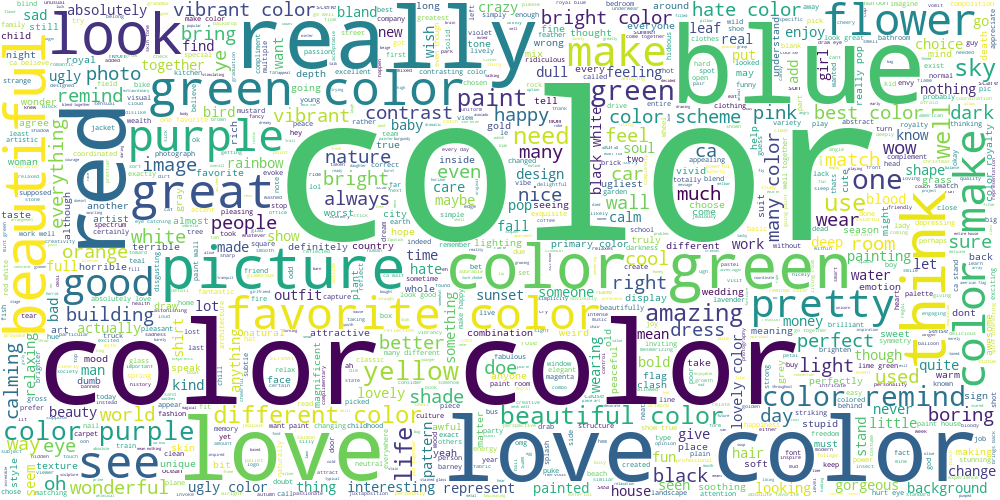


*********************************
label 25
*********************************



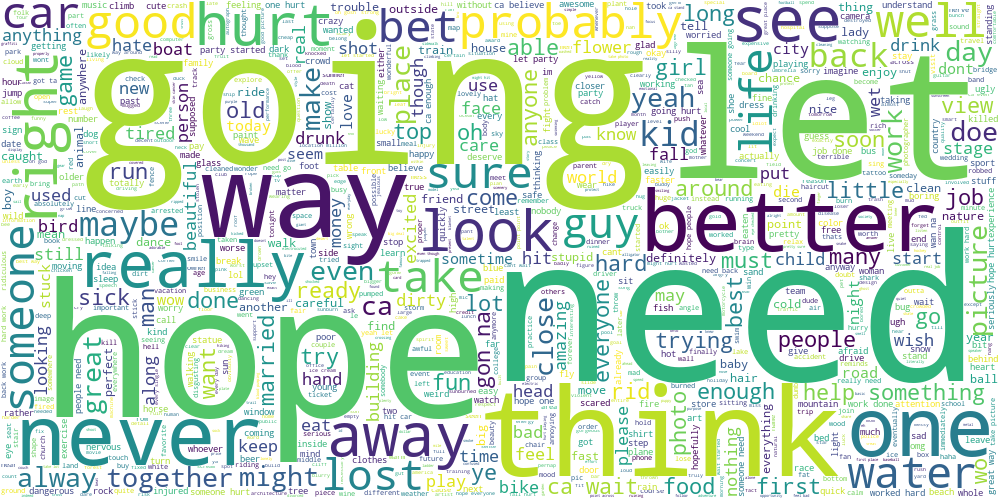


*********************************
label 26
*********************************



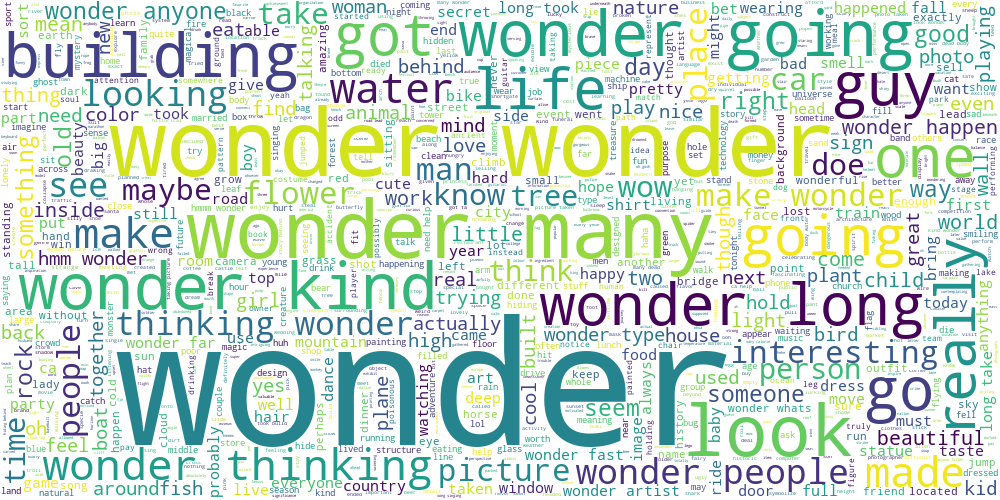


*********************************
label 27
*********************************



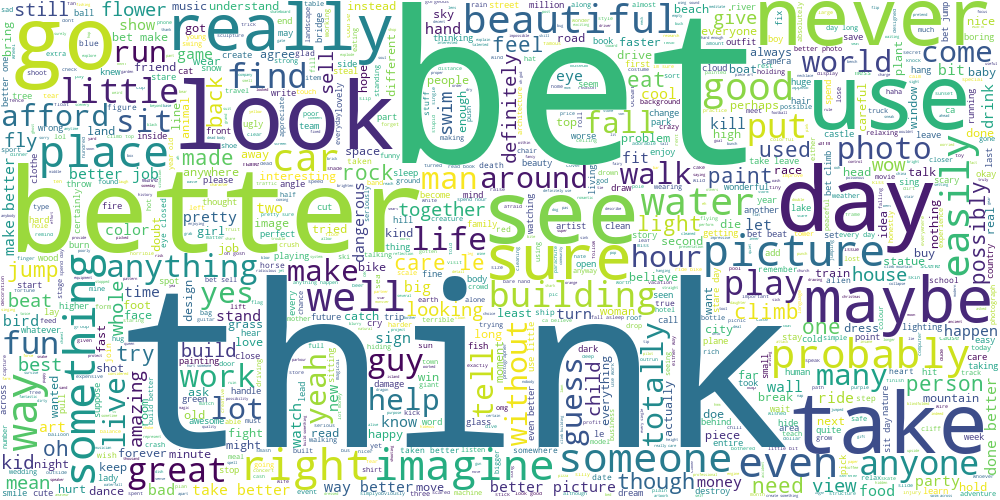


*********************************
label 28
*********************************



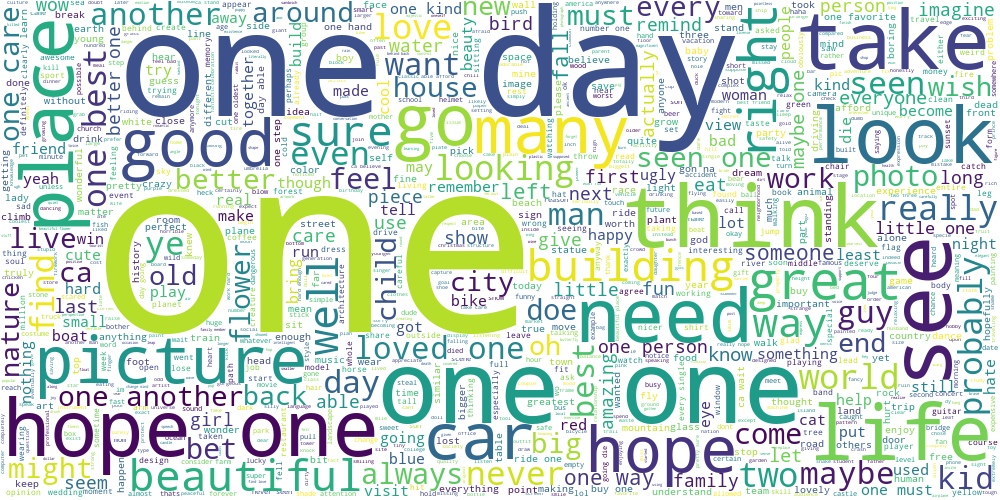


*********************************
label 29
*********************************



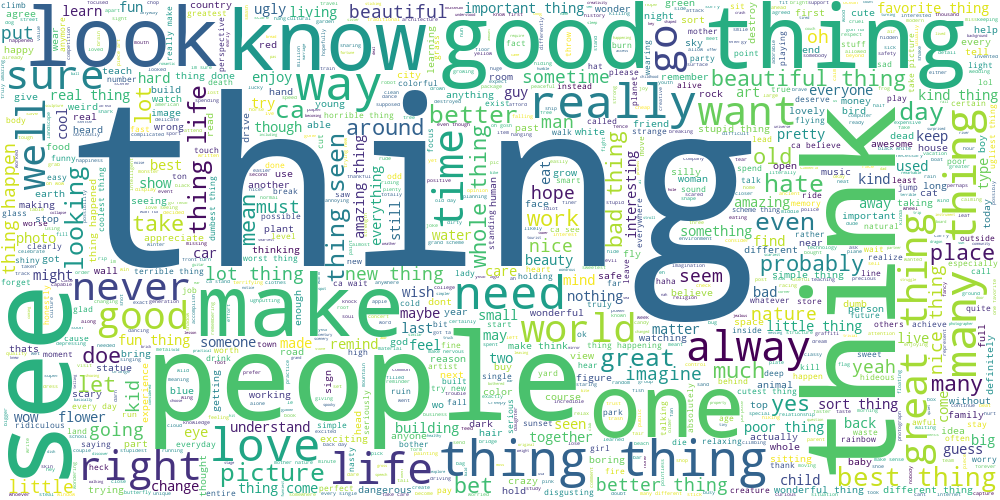

In [ ]:
display_clusters(sents_preproc_full, labels_full)

В этих примерах можно рассмотреть структуру предложений. Можно заметить, что случаются "битые": с опечатками или не законченные. Структура предложений примерно похожая, они простые, но достаточно разнообразные, чтобы встретить среди них одинаковые по смыслу примеры. Возможно, дубликаты встречаются среди коротких предложений.

In [ ]:
print_cluster_samples(sentences_full, labels_full, 15)


*********************************
label 0
*********************************

Is she like going to throw the ball?
This trolley is going too fast and makes the picture too blurry but it is a nice scene.
Not much going on in this one
They are not going to be very good at body boarding.
I took this picture and picked the location, this is going to be the best party ever!
Obviously there isn't much going on here since the guy in blue doesn't have his mask down.
They are going to save the world
Those cacti inspire me to head west, I'm going to buy my ticket right now.
What's going on? Why these kids are walking in a line on the field?
not sure this is actually going to help
the guys should move their heads so I can see what is going on.
I am going to do it without the safety equipment, I feel daring!
He should be so proud of where he's going!
He is going out on the main road soon.  I gave him a blindfold.
No, that piglet is going to be dinner tonight.

*********************************
lab

Моделирование не кластеризовало стили.

In [ ]:
print_cluster_stats(sentences_full, labels_full)


*********************************
label 0
*********************************

Different styles: 215
Mean sentence length: 56.4858142246405

*********************************
label 1
*********************************

Different styles: 214
Mean sentence length: 59.5916955017301

*********************************
label 2
*********************************

Different styles: 215
Mean sentence length: 43.18475904618976

*********************************
label 3
*********************************

Different styles: 195
Mean sentence length: 61.67080745341615

*********************************
label 4
*********************************

Different styles: 215
Mean sentence length: 56.13335485954149

*********************************
label 5
*********************************

Different styles: 215
Mean sentence length: 54.744578863273226

*********************************
label 6
*********************************

Different styles: 215
Mean sentence length: 47.40208333333333

********************

Далее представлены аналогичные эксперименты с предложениями конкретного стиля. Можно заметить две вещи: для стиля есть набор ключевых слов (мудрый собеседник что-то советует, нередко прибегая к пословицам) и нередко предложения четко не соответствуют стилям. Также присутствуют опечатки.

In [ ]:
labels_wise = build_clusters(styles_to_sentences['Wise'], 3, 'count')


*********************************
label 0
*********************************



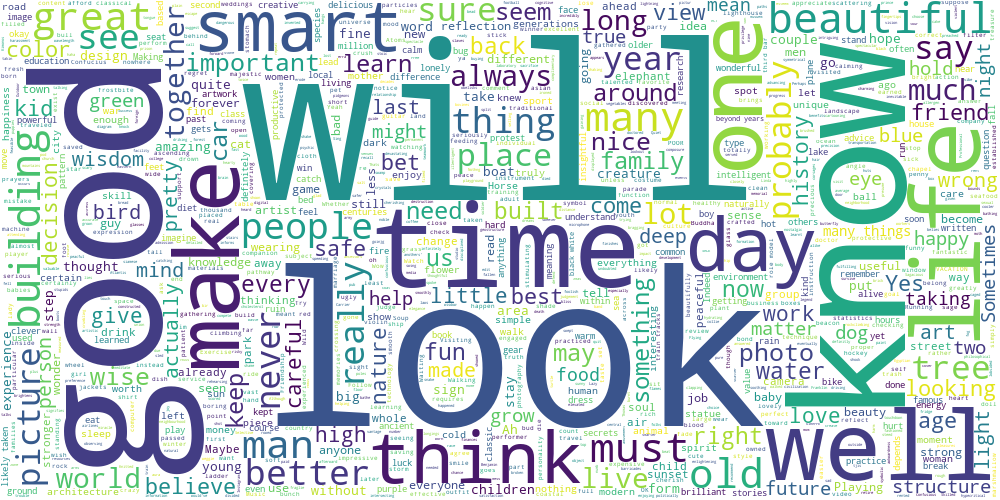


*********************************
label 1
*********************************



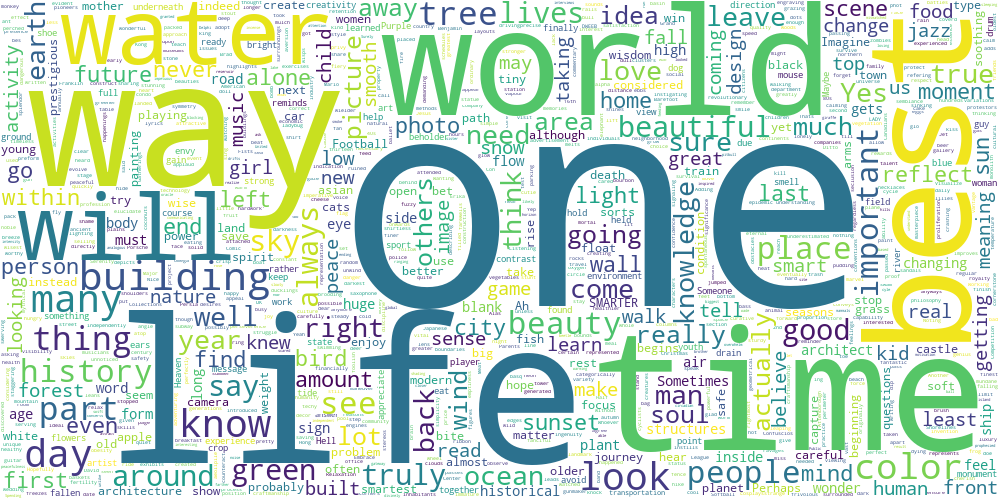


*********************************
label 2
*********************************



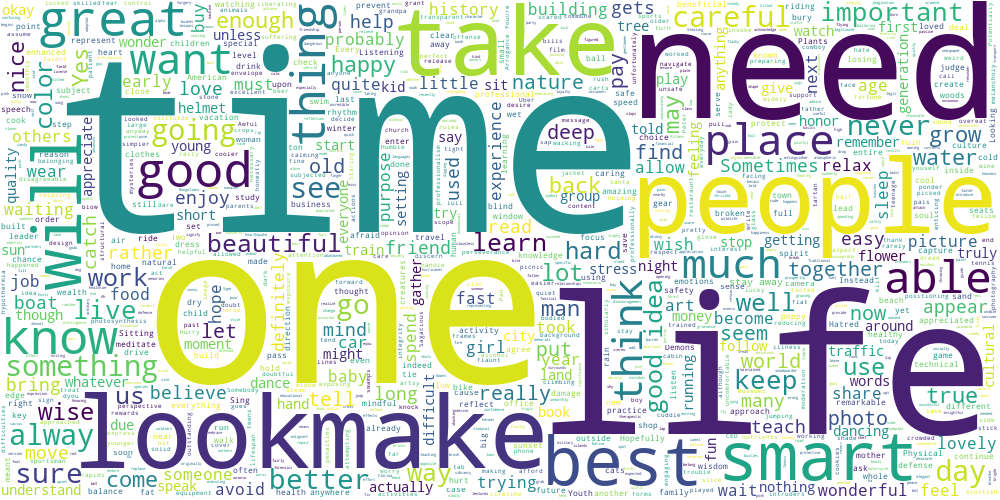

In [ ]:
display_clusters(styles_to_sentences['Wise'], labels_wise)

In [ ]:
print_cluster_samples(styles_to_sentences['Wise'], labels_wise, 10)


*********************************
label 0
*********************************

I visited here once a few years back, a beautiful place
this symbol is from a gang and you should avoid areas where you see this.
No, so they don't drown
I've actually seen him perform.
A white board would be more effective long term here
Being in a place like this makes be believe in our Country.
If he wasnt wearing a sweater his outfit would be rediculous
The lighthouse is important but lonely.
the filter is from an old Instagram photo. It is a nostalgic edit. 
You shouldn't sleep on a sled.

*********************************
label 1
*********************************

Although it looks dangerous, the child learns and gains knowledge of the world
The sky reflects what you feel inside.  The emptiness is within you.
The brain is full of wonder.
The end result is the great motivation.
The least you can say is the best way to say things.
The beauty of nature is eternal. 
It is always good to remember the powerfu

In [ ]:
labels_curious = build_clusters(styles_to_sentences['Curious'], 3)


*********************************
label 0
*********************************



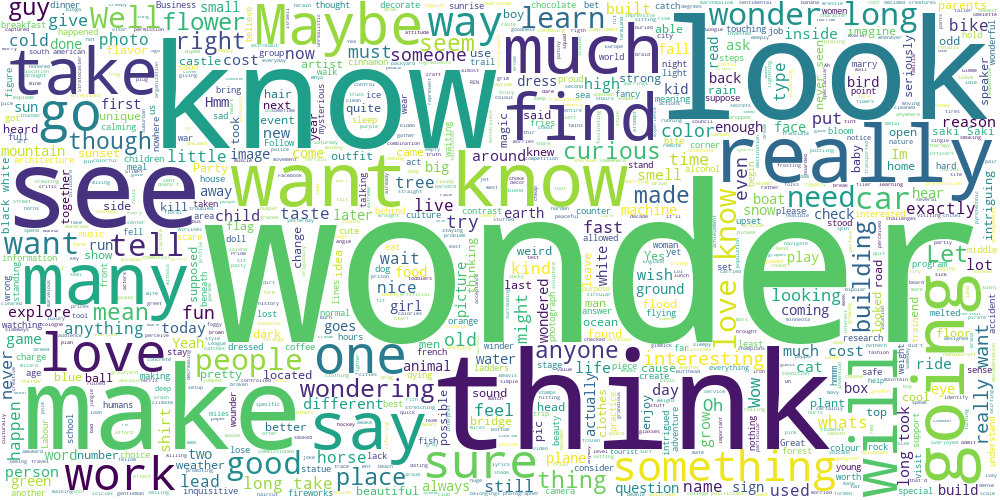


*********************************
label 1
*********************************



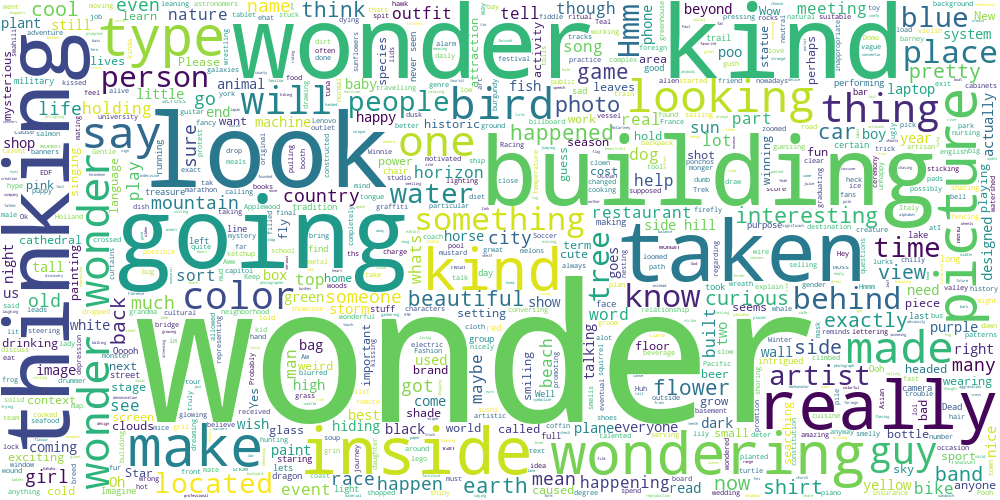


*********************************
label 2
*********************************



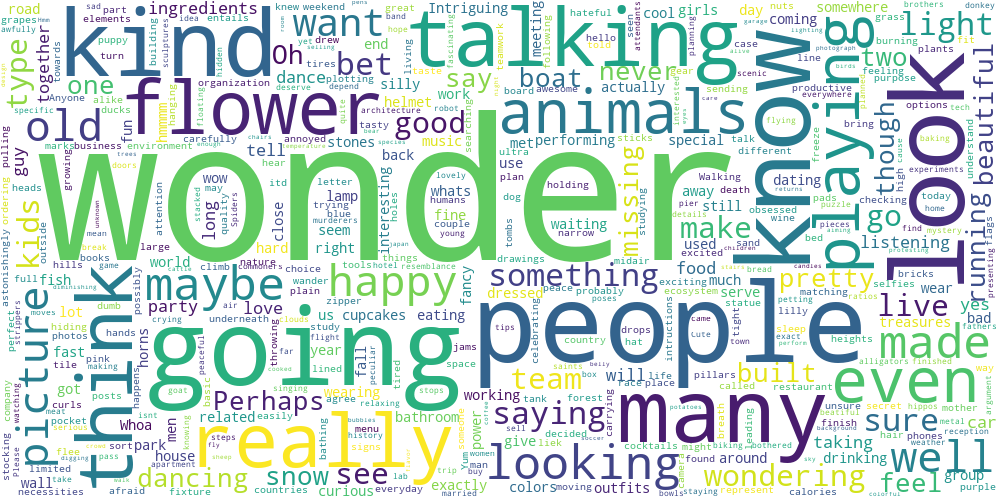

In [ ]:
display_clusters(styles_to_sentences['Curious'], labels_curious)

In [ ]:
print_cluster_samples(styles_to_sentences['Curious'], labels_curious, 10)


*********************************
label 0
*********************************

I just wanna know how many people live there, what they do
I would love to know who designed it.  The architecture is beautiful.
That ostrich seems to be really fixated on something near the floor, wonder what it is?
Why didn't you answer my question?
Riding bikes with a tropical storm coming sure is odd. I hope they run their errand quickly and return to safety.
It looks like it goes forever.. Really makes me wonder!
If there was asbestos what would that mean?
I wonder where you find these?
how much practice does it take to perform for a live audience 
Well you never really know, she could be blue in the face and this is a creepy pic, or it's a photo tint.

*********************************
label 1
*********************************

What in the world is this?!
I wonder why she is  on stage
I wonder what he is cooking up!
hmm, I wonder if that is a really small tablet or laptop? Where does it charge?
Where is